# Map a query dataset to Pan Fetal Immune data 

In this notebook, we use the scArches method to map query dataset to the scVI model trained on the pan-fetal dataset. Roughly following the [vignette](https://docs.scvi-tools.org/en/stable/user_guide/notebooks/scarches_scvi_tools.html#) in scvi-tools.

In [80]:
import sys,os
import scvi
import anndata
import matplotlib
import seaborn as sns
from matplotlib import colors
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.colors import LinearSegmentedColormap

import numpy as np
import pandas as pd
import scanpy as sc
import numpy.random as random
import scipy

In [3]:
sc.set_figure_params(figsize=(4, 4))
scvi.settings.seed = 94705

Import mapping wrappers

In [195]:
## import utils
cwd = '.'
sys.path.append(cwd)

from map_query_utils import *

## Sanity check - try remapping part of the reference

Take out data from one batch (donor+library prep method) 

In [370]:
# Load obs
new_obs = pd.read_csv(scvi_outs_dir + "PAN.A01.v01.entire_data_normalised_log.{t}.full_obs.csv".format(t=timestamp), index_col=0)
ref_adata.obs = new_obs.loc[ref_adata.obs_names]

ref_adata.obs["bbk"] = ref_adata.obs["method"] + ref_adata.obs["donor"]
ref_query_adata = ref_adata[ref_adata.obs["bbk"] == '5GEXF50']

In [371]:
ref_query_adata_mapped, vae_nkt = _map_query_to_panfetal(ref_query_adata, split="NKT",  
                                            scvi_outs_dir = "/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/",
                                            batch_name='5GEXF50_1')

WARNING  Query integration should be performed using models trained with version >= 0.8      
INFO     .obs[_scvi_labels] not found in target, assuming every cell is same category        
INFO     Using data from adata.X                                                             
INFO     Computing library size prior per batch                                              
INFO     Registered keys:['X', 'batch_indices', 'local_l_mean', 'local_l_var', 'labels']     
INFO     Successfully registered anndata object containing 10422 cells, 7499 vars, 33        
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  


GPU available: False, used: False
TPU available: None, using: 0 TPU cores


Epoch 3/200:   1%|          | 2/200 [00:08<13:43,  4.16s/it, loss=1.17e+03, v_num=1]


### Visualize with reference

In [248]:
ref_query_adata_mapped.obsm["X_scvi"] = ref_query_adata_mapped.obsm["X_scVI_project"]

# ref_query_adata_mapped.obs = pd.concat([ref_query_adata_mapped.obs, ref_query_adata.obs], 1)
# ref_query_adata_mapped.obs = ref_query_adata_mapped.obs.loc[:,~ref_query_adata_mapped.obs.columns.duplicated(keep="first")]

ref_query_adata_mapped.obs["bbk"] = ref_query_adata_mapped.obs["bbk"]+"_1"

In [262]:
concat_adata = ref_adata.concatenate(ref_query_adata_mapped, batch_key="dataset", batch_categories=["reference", "query"])

In [263]:
sc.pp.neighbors(concat_adata, use_rep="X_scvi", n_neighbors = 30)

In [264]:
sc.tl.umap(concat_adata, min_dist = 0.01, spread = 2)

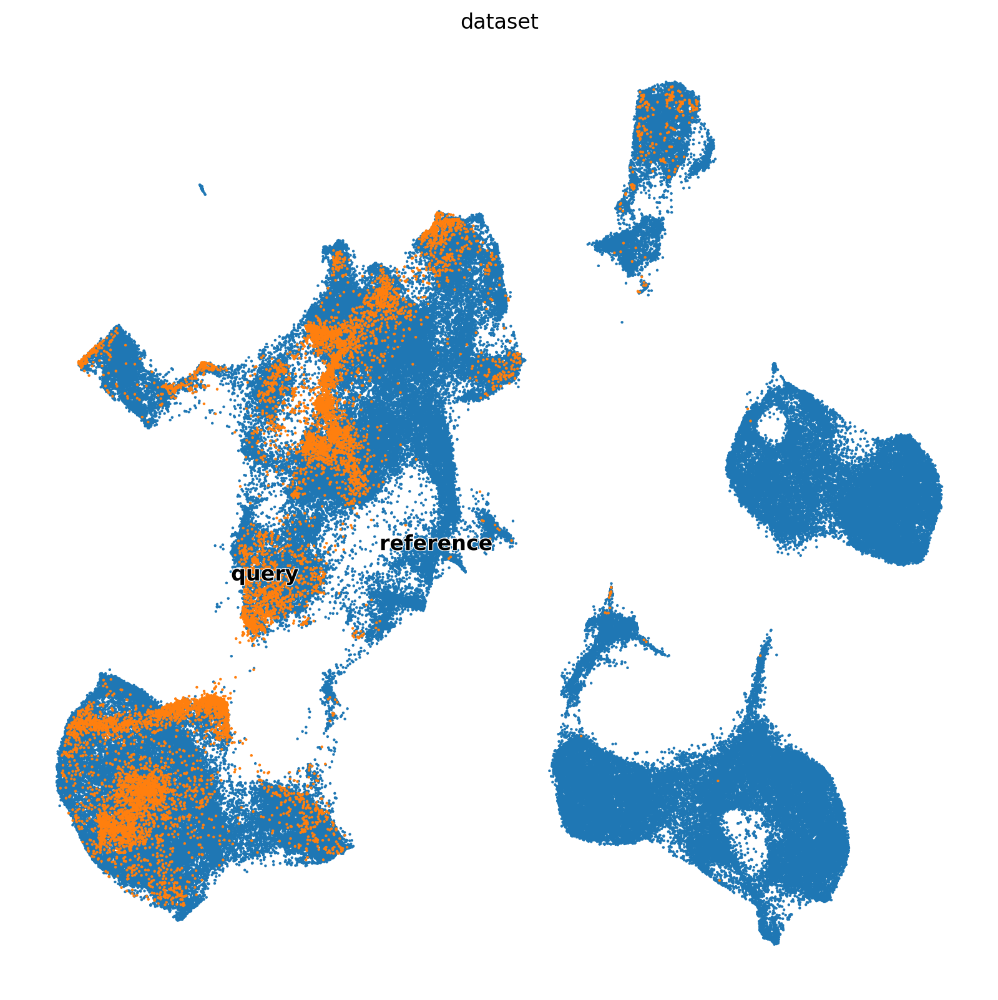

In [267]:
plt.rcParams["figure.figsize"] = [10,10]
sc.pl.umap(
    concat_adata, 
    color=["dataset"],
    legend_loc="on data",
    size=10
)


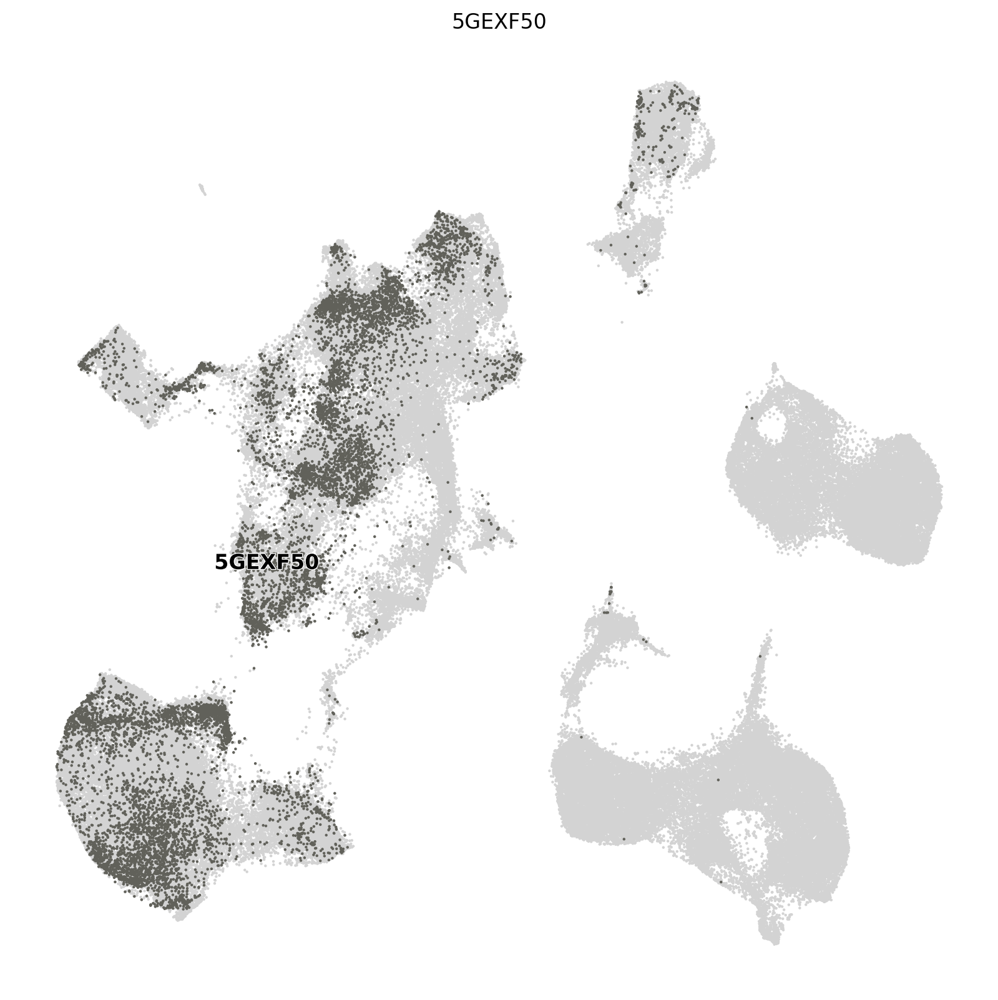

In [270]:
sc.pl.umap(
    concat_adata, 
    color=["bbk"],
    legend_loc="on data",
    groups=['5GEXF50'],
    size=10
)


Check distance to true matched cell in reference (check that it's not 0)

In [286]:
emb_ref = ref_adata[ref_adata.obs["bbk"] == '5GEXF50'].obsm["X_scvi"].copy()
emb_que = ref_query_adata_mapped.obsm["X_scvi"].copy()

In [294]:
from scipy.spatial.distance import cdist

In [307]:
emb_rand = sc.pp.subsample(ref_adata,n_obs=ref_query_adata_mapped.n_obs, copy=True).obsm["X_scvi"].copy()

In [308]:
pt_distances_true = np.diag(cdist(emb_ref, emb_que))
pt_distances_random = np.diag(cdist(emb_rand, emb_que))

Text(0, 0.5, '# cells')

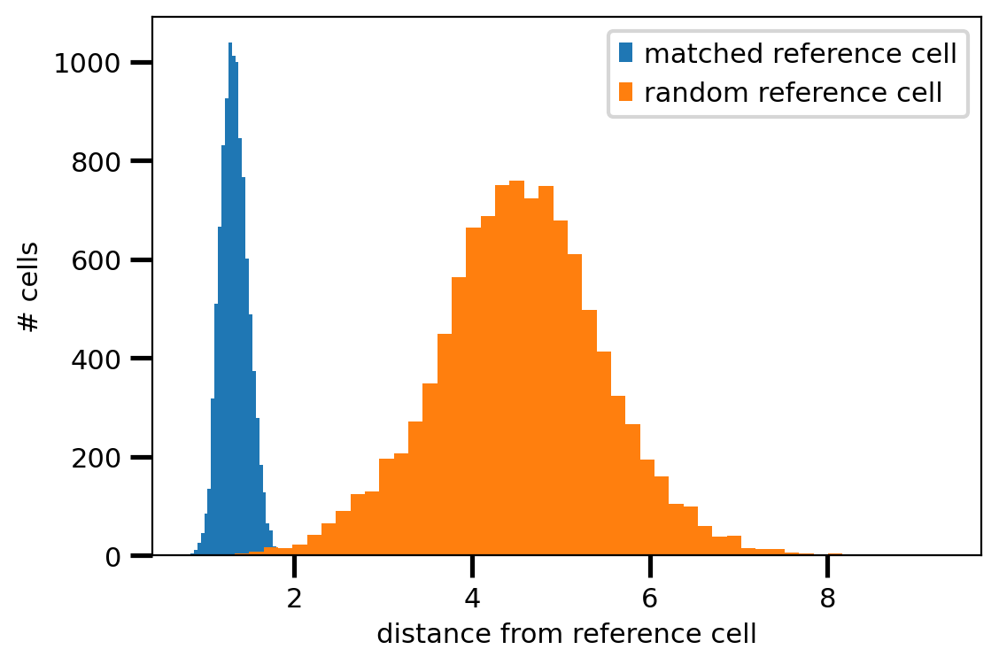

In [328]:
plt.rcParams["figure.figsize"] = [6,4]
plt.hist(pt_distances_true, bins=30, label="matched reference cell");
plt.hist(pt_distances_random, bins=50, label="random reference cell");
plt.legend();
plt.xlabel("distance from reference cell");
plt.ylabel("# cells")
# plt.boxplot([pt_distances_true, pt_distances_random]);
# plt.xticks(["ciao", "ciaone"])

## NKT cells - pediatric gut

### Read mapping results

Obtained on GPU node running `run_map_query.py`


In [184]:
query_h5ad_file = '/home/jupyter/pediatric_RAWCOUNTS_cellxgene_NKT.query.mapped2NKT.h5ad'
split = "NKT"
ref_data_dir = '/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/'
timestamp = '20210429'

merged_adata = _merge_query_and_reference(query_h5ad_file, split)

In [200]:
merged_adata

AnnData object with n_obs × n_vars = 175513 × 7499
    obs: 'n_counts', 'n_genes', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'Age', 'Diagnosis', 'Sample name', 'Type', 'batch', 'percent_mito', 'annotation_V2', 'inferred state', 'bbk', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'dataset'
    var: 'GeneID-reference', 'GeneName-reference'
    uns: 'neighbors'
    obsm: 'X_scvi'
    obsp: 'distances', 'connectivities'

### Predict cell type labels

In [ ]:
## Load reference annotations
anno_obs = pd.read_csv("/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv", index_col=0)

reference_obs = merged_adata.obs_names[merged_adata.obs.dataset == "reference"]
merged_adata.obs["annotation_reference"] = np.nan
merged_adata.obs.loc[reference_obs, "annotation_reference"] = anno_obs.loc[reference_obs.str.strip("-reference")]["anno_lvl_2_final_clean"].values

In [207]:
predict_label(merged_adata, anno_col="annotation_reference")

/home/jupyter/Pan_fetal_immune/src/8_align_query/map_query_utils.py:117: RuntimeWarning: invalid value encountered in true_divide
  return(concat_adata)


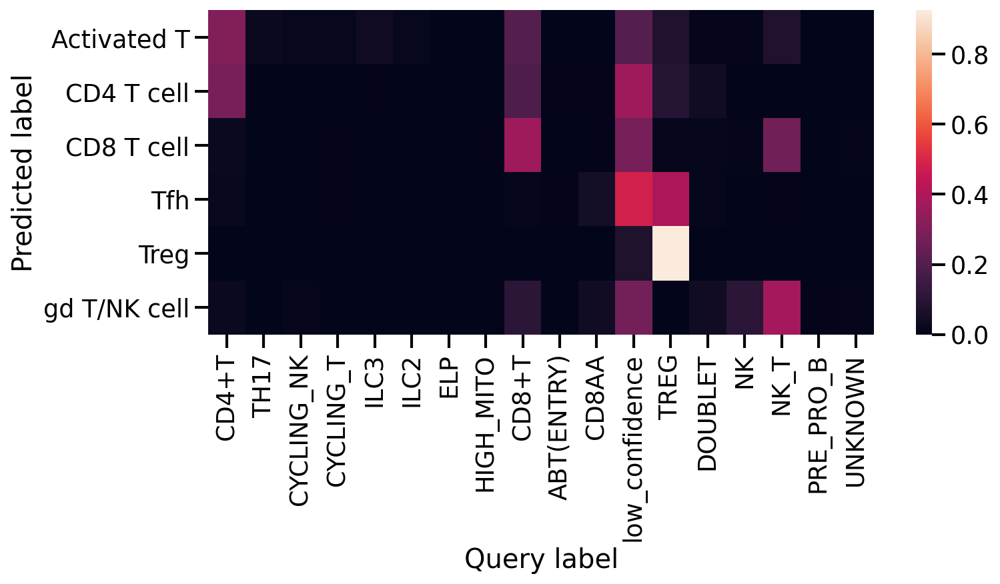

In [214]:
plt.rcParams["figure.figsize"] = [10,4]
plot_confusion_mat(merged_adata, query_anno_col="annotation_V2", show_low_confidence=True)

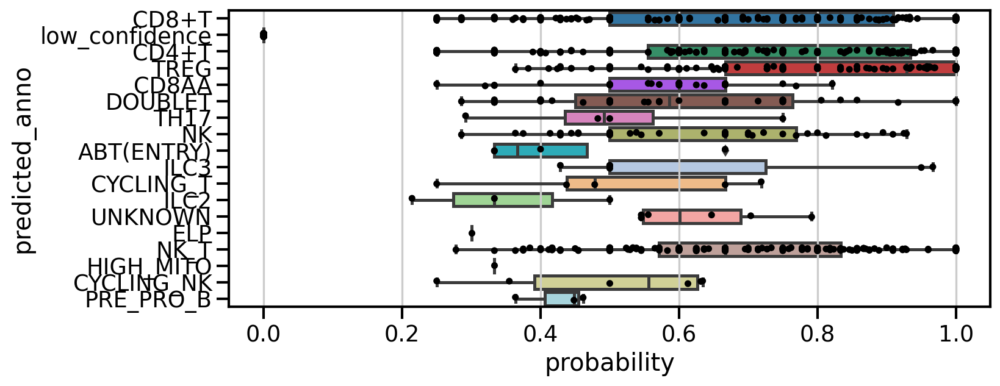

In [215]:
plot_predicted_anno_probability(merged_adata)

In [374]:
query_anno_col = "annotation_V2"
query_adata_mapped = merged_adata[merged_adata.obs["dataset"] == "query"]
# sc.pp.neighbors(query_adata_mapped, use_rep="X_scvi", n_neighbors=30, key_added="scvi")

In [448]:
compute_nmi(query_adata_mapped, query_anno_col)

0.31062816557190187

## all cells - pediatric gut - with batch

### Read mapping results

In [484]:
query_h5ad_file = '/home/jupyter/pediatric_RAWCOUNTS_cellxgene.query.with_bbk.mapped2HSC_IMMUNE.h5ad'
split = "HSC_IMMUNE"
ref_data_dir = '/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/'
timestamp = '20210429'

merged_adata = _merge_query_and_reference(query_h5ad_file, split)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


### Predict cell type labels

In [485]:
## Load reference annotations
anno_obs = pd.read_csv("/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv", index_col=0)

reference_obs = merged_adata.obs_names[merged_adata.obs.dataset == "reference"]
merged_adata.obs["annotation_reference"] = np.nan
merged_adata.obs.loc[reference_obs, "annotation_reference"] = anno_obs.loc[reference_obs.str.strip("-reference")]["anno_lvl_2_final_clean"].values

/opt/conda/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3170: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [486]:
predict_label(merged_adata, anno_col="annotation_reference")

/home/jupyter/Pan_fetal_immune/src/8_align_query/map_query_utils.py:117: RuntimeWarning: invalid value encountered in true_divide
  return(concat_adata)


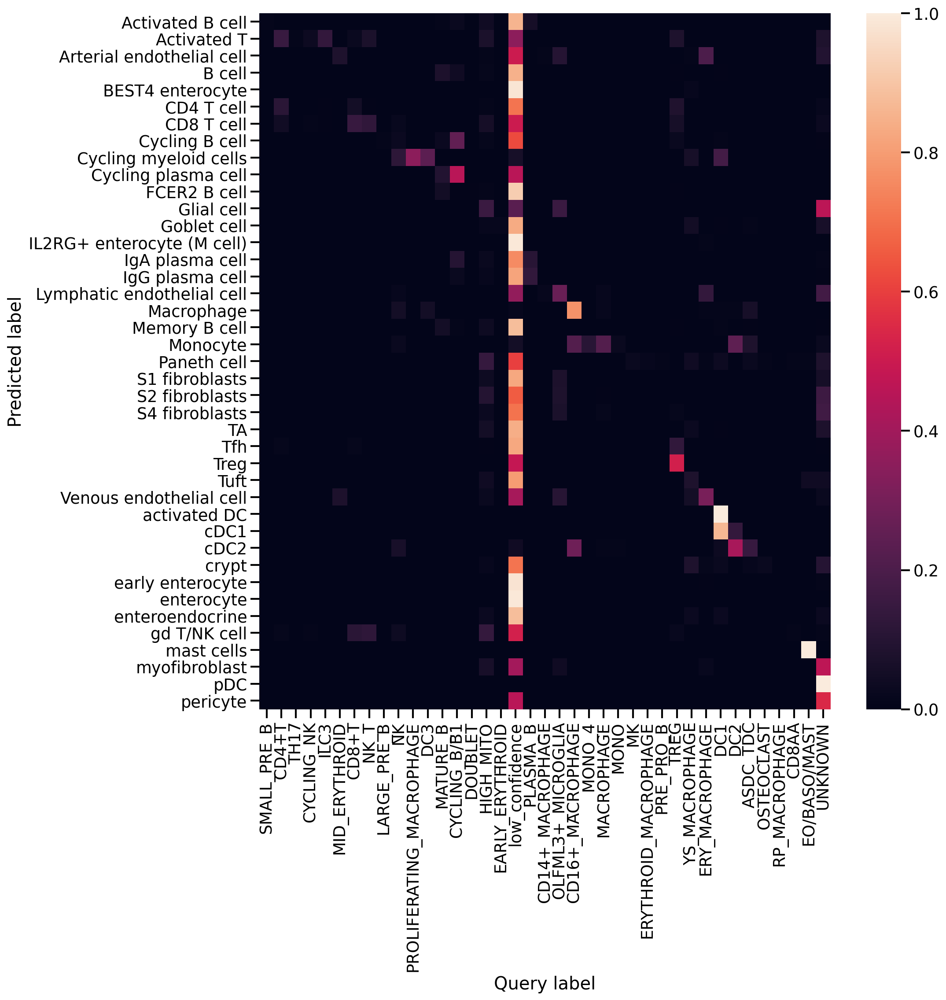

In [491]:
plt.rcParams["figure.figsize"] = [13,13]
plot_confusion_mat(merged_adata, query_anno_col="annotation_V2", show_low_confidence=True)
plt.savefig("/home/jupyter/conf_mat_with_bbk.mapped2HSC_IMMUNE.png", bbox_inches="tight")

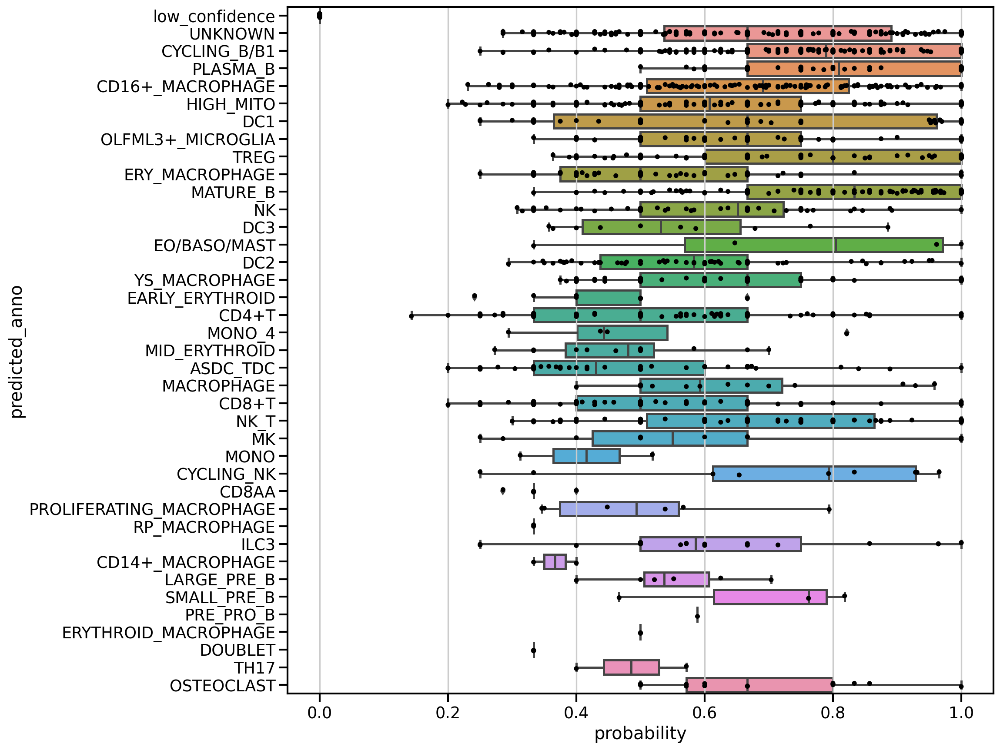

In [492]:
plot_predicted_anno_probability(merged_adata)
plt.savefig("/home/jupyter/label_prob_with_bbk.mapped2HSC_IMMUNE.png", bbox_inches="tight")

In [493]:
query_anno_col = "annotation_V2"
query_adata_mapped = merged_adata[merged_adata.obs["dataset"] == "query"]
# sc.pp.neighbors(query_adata_mapped, use_rep="X_scvi", n_neighbors=30, key_added="scvi")

In [494]:
compute_nmi(query_adata_mapped, query_anno_col)

0.4980663588023253

## all cells - pediatric gut - without batch

### Read mapping results

In [472]:
query_h5ad_file = '/home/jupyter/pediatric_RAWCOUNTS_cellxgene.query.without_bbk.mapped2HSC_IMMUNE.h5ad'
split = "HSC_IMMUNE"
ref_data_dir = '/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/'
timestamp = '20210429'

merged_adata = _merge_query_and_reference(query_h5ad_file, split)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


### Predict cell type labels

In [473]:
## Load reference annotations
anno_obs = pd.read_csv("/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv", index_col=0)

reference_obs = merged_adata.obs_names[merged_adata.obs.dataset == "reference"]
merged_adata.obs["annotation_reference"] = np.nan
merged_adata.obs.loc[reference_obs, "annotation_reference"] = anno_obs.loc[reference_obs.str.strip("-reference")]["anno_lvl_2_final_clean"].values

/opt/conda/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3170: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [474]:
predict_label(merged_adata, anno_col="annotation_reference")

/home/jupyter/Pan_fetal_immune/src/8_align_query/map_query_utils.py:117: RuntimeWarning: invalid value encountered in true_divide
  return(concat_adata)


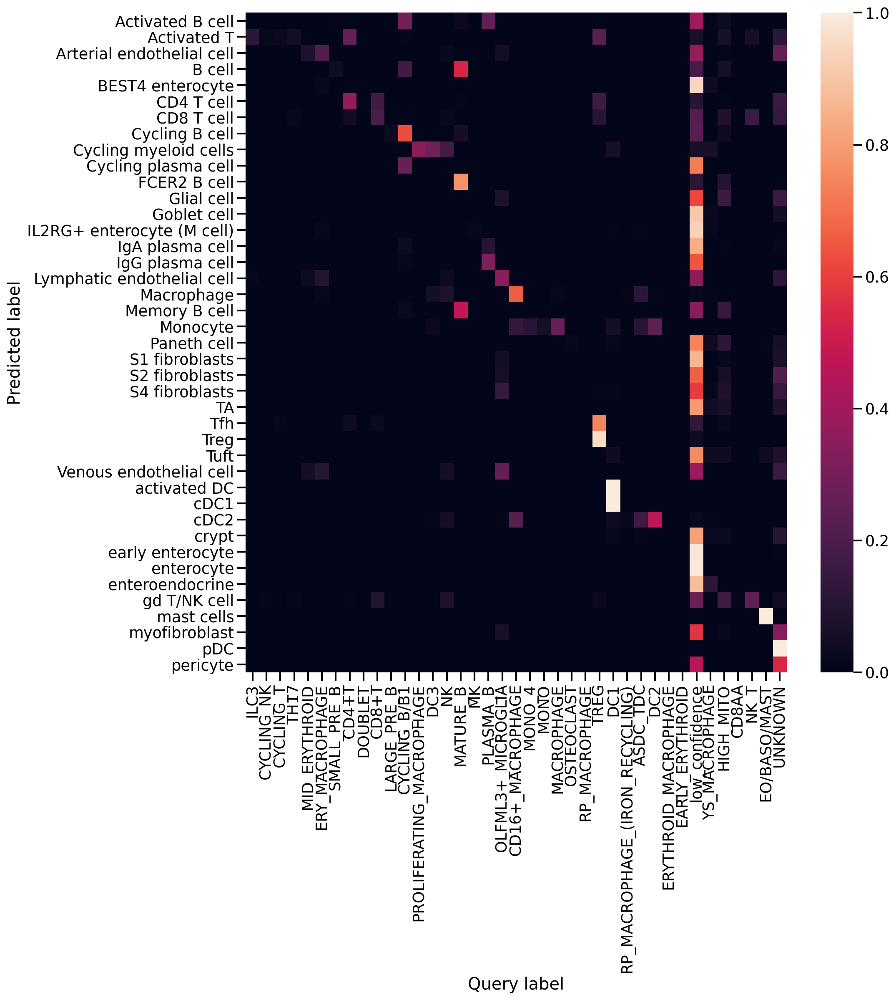

In [482]:
plt.rcParams["figure.figsize"] = [13,13]
plot_confusion_mat(merged_adata, query_anno_col="annotation_V2", show_low_confidence=True)
plt.savefig("/home/jupyter/conf_mat_without_bbk.mapped2HSC_IMMUNE.png", bbox_inches="tight")

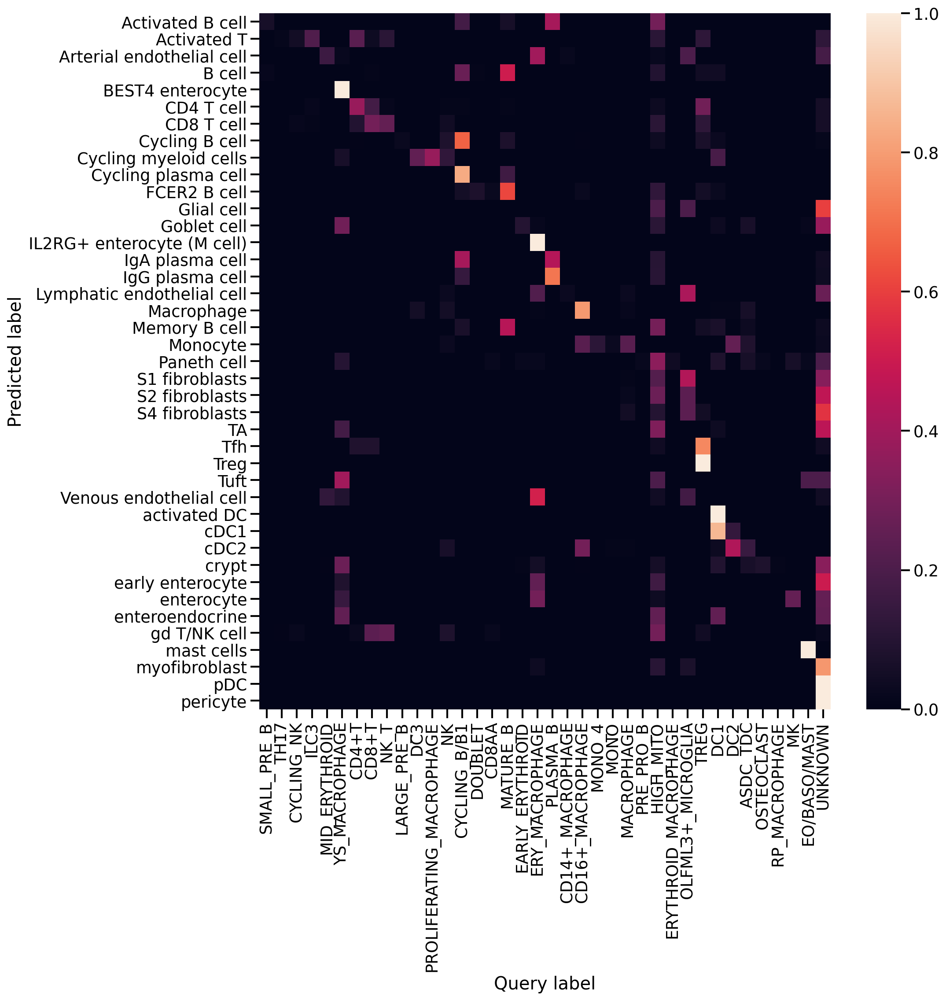

In [495]:
plot_confusion_mat(merged_adata, query_anno_col="annotation_V2", show_low_confidence=False)


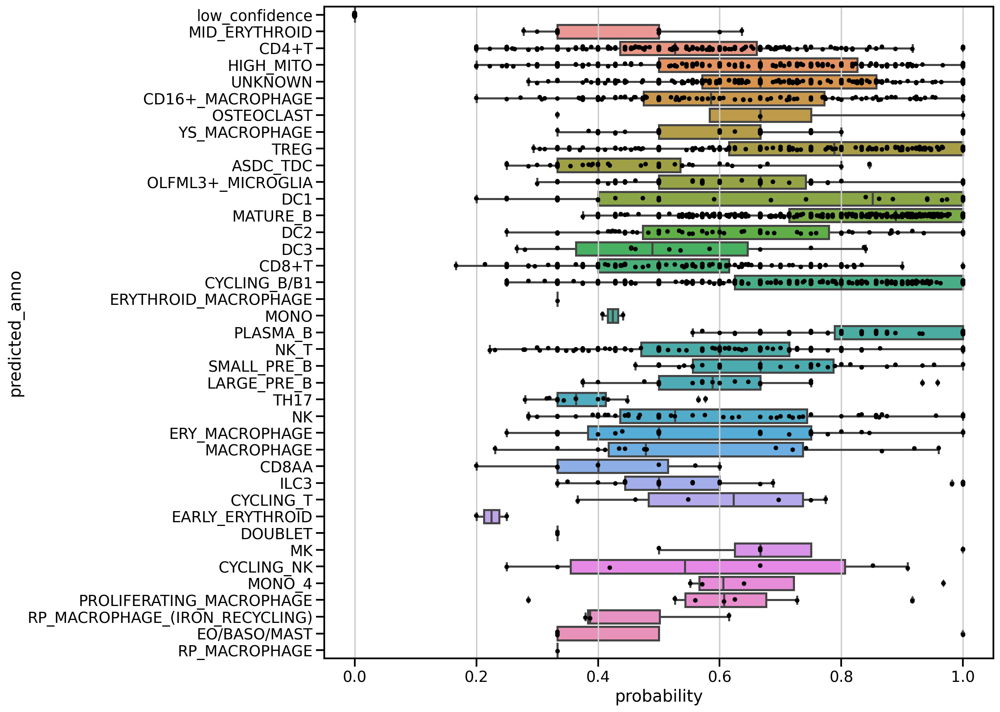

In [483]:
plot_predicted_anno_probability(merged_adata)
plt.savefig("/home/jupyter/label_prob_without_bbk.mapped2HSC_IMMUNE.png", bbox_inches="tight")

In [477]:
query_anno_col = "annotation_V2"
query_adata_mapped = merged_adata[merged_adata.obs["dataset"] == "query"]
# sc.pp.neighbors(query_adata_mapped, use_rep="X_scvi", n_neighbors=30, key_added="scvi")

In [478]:
compute_nmi(query_adata_mapped, query_anno_col)

0.5410734863287783

---

In [379]:
sc.pp.neighbors(query_adata_mapped, use_rep="X_scvi", n_neighbors=30)
knn_similarity_mat = query_adata_mapped.obsp["distances"].toarray()
knn_similarity_mat[knn_similarity_mat.nonzero()] = 1/(1 + knn_similarity_mat[knn_similarity_mat.nonzero()])

anno_dummies = pd.get_dummies(query_adata_mapped.obs[query_anno_col])

anno_sim_within = {}
anno_sim_between = {}
anno_sim_ratio={}
for a in anno_dummies.columns:
    anno_ixs = np.where((anno_dummies[a]==1).values)[0]
    not_anno_ixs = np.where((anno_dummies[a]==0).values)[0]
    ## Calc mean similarity within class
    anno_sim_mat = np.triu(knn_similarity_mat[anno_ixs, :][:,~anno_ixs])
#     anno_dist_mat[anno_dist_mat.nonzero()] = 1/(1+anno_dist_mat[anno_dist_mat.nonzero()])
    anno_mean_sim_within = anno_sim_mat.mean()
    anno_sim_within[a] = anno_mean_sim_within
    ## Calc mean similarity with other classes
    anno_sim_mat = knn_similarity_mat[anno_ixs, :][:,not_anno_ixs]
#     anno_dist_mat[anno_dist_mat.nonzero()] = 1/(1+anno_dist_mat[anno_dist_mat.nonzero()])
    anno_mean_sim_between = anno_sim_mat.mean()
    anno_sim_between[a] = anno_mean_sim_between
    anno_sim_ratio[a] = anno_mean_sim_within/anno_mean_sim_between
    


In [343]:
anno_similarity_df

,query_annotation,similarity_within,similarity_random
0,Activated T,0.024084,0.005384
1,CD4 T cell,0.012900,0.005336
2,CD8 T cell,0.017626,0.005117
3,Tfh,0.027362,0.005455
4,Treg,0.044435,0.005499
5,gd T/NK cell,0.013807,0.004692


## Map query dataset

#### Load query dataset

Pediatric gut data

In [ ]:
!wget https://cellgeni.cog.sanger.ac.uk/gutcellatlas/pediatric_RAWCOUNTS_cellxgene.h5ad

In [11]:
query_adata = sc.read_h5ad("pediatric_RAWCOUNTS_cellxgene.h5ad")

## subset healthy controls
query_adata = query_adata[query_adata.obs["Diagnosis"] == "Normal control"]

## Convert var_names to gene IDS
query_adata.var["gene_name"] = query_adata.var_names.copy()
query_adata.var_names = query_adata.var["gene_ids"].values

## Rename column of technical samples (as used by original model) 
query_adata.obs["bbk"] = query_adata.obs["Sample name"]

Trying to set attribute `.var` of view, copying.


In [12]:
query_adata_mapped, vae = _map_query_to_panfetal(query_adata, split="HSC_IMMUNE",  
                                            scvi_outs_dir = "/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/",
                                            batch_name="gut_pediatric", 
                                            model_dir = "scvi_HSC_IMMUNE_model_test/")

INFO     .obs[_scvi_labels] not found in target, assuming every cell is same category        
INFO     Using data from adata.X                                                             
INFO     Computing library size prior per batch                                              
INFO     Registered keys:['X', 'batch_indices', 'local_l_mean', 'local_l_var', 'labels']     
INFO     Successfully registered anndata object containing 10411 cells, 7500 vars, 40        
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  


/opt/conda/lib/python3.7/site-packages/scvi/model/base/_archesmixin.py:94: UserWarning: Query integration should be performed using models trained with version >= 0.8
  "Query integration should be performed using models trained with version >= 0.8"
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 200/200: 100%|██████████| 200/200 [02:27<00:00,  1.36it/s, loss=1.57e+03, v_num=1]


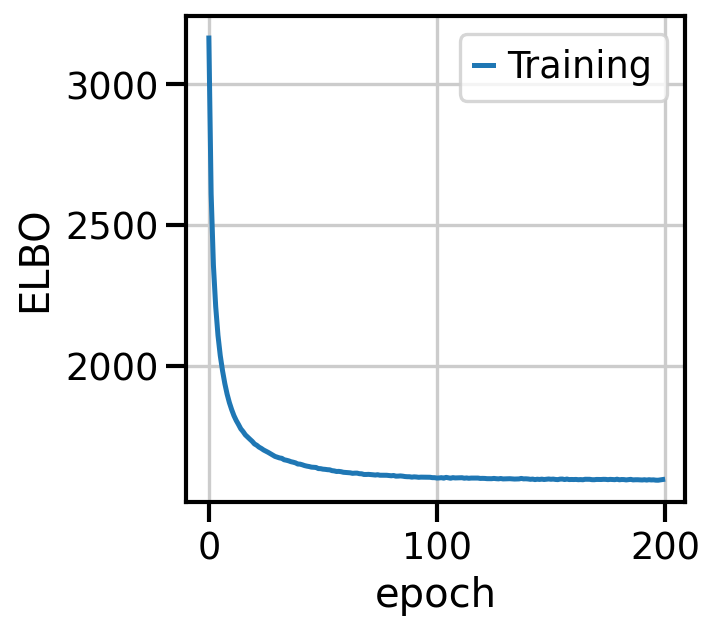

In [13]:
## Plot convergence
sns.set_context("talk")
plt.plot(vae.history["elbo_train"], label="Training");
# plt.plot(vae.history["elbo_validation"], label="Validation");
plt.legend();
plt.xlabel("epoch");
plt.ylabel("ELBO");


In [14]:
sc.pp.neighbors(query_adata_mapped, use_rep="X_scVI_project")
# sc.tl.leiden(query_adata_mapped)

In [15]:
sc.tl.umap(query_adata_mapped)

In [159]:
try

SyntaxError: invalid syntax (<ipython-input-159-13deaccc167b>, line 1)

In [163]:
if not query_adata.var_names.str.startswith("ENS").all():

True

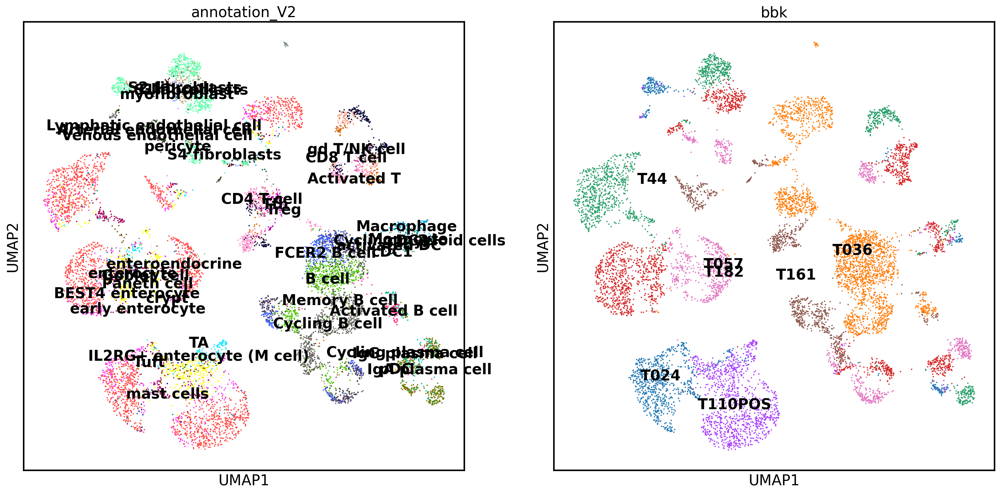

In [16]:
plt.rcParams["figure.figsize"] = [10,10]
sc.pl.umap(
    query_adata_mapped, 
    color=["annotation_V2", "bbk"],
    legend_loc="on data"
)

In [17]:
split="HSC_IMMUNE"
scvi_outs_dir = "/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/"
timestamp = "20210429"

ref_adata = sc.read_h5ad(scvi_outs_dir + 'PAN.A01.v01.entire_data_raw_count.{t}.{s}.h5ad'.format(t=timestamp, s=split))
ref_embedding = np.load(scvi_outs_dir + 'PAN.A01.v01.entire_data_raw_count.{t}.{s}.scVI_out.npy'.format(t=timestamp, s=split))
ref_adata.obsm["X_scvi"] = ref_embedding

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [19]:
ref_adata.var_names = ref_adata.var.GeneID

In [275]:
# smp_ref_adata = sc.pp.subsample(ref_adata, fraction=0.1, copy=True)
# smp_ref_adata.var_names = smp_ref_adata.var.GeneID

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [20]:
query_adata_mapped.obsm["X_scvi"] = query_adata_mapped.obsm["X_scVI_project"]

In [21]:
concat_adata = ref_adata.concatenate(query_adata_mapped, batch_key="dataset", batch_categories=["reference", "query"])
sc.pp.neighbors(concat_adata, use_rep="X_scvi", n_neighbors = 30)
# sc.tl.leiden(query_adata_mapped)

In [122]:
# sc.tl.umap(concat_adata)

# plt.rcParams["figure.figsize"] = [15,15]
# sc.pl.umap(
#     concat_adata, 
#     color=["annotation_V2","dataset"],
#     legend_loc="on data",
#     size=5
# )


# scv.pl.umap(
#     concat_adata, 
#     color=["annotation_V2"],
#     legend_loc="on data",
#     groups=query_adata.obs["annotation_V2"].unique().tolist(),
#     size=5
# )

#### predict labels

In [34]:
## Load reference annotations
anno_obs = pd.read_csv("/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv", index_col=0)
concat_adata.obs["annotation_reference"] = np.nan
concat_adata.obs.loc[ref_adata.obs_names + "-reference", "annotation_reference"] = anno_obs.loc[ref_adata.obs_names]["anno_lvl_2_final_clean"].values

In [55]:
predict_label(concat_adata, "annotation_reference")

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in true_divide


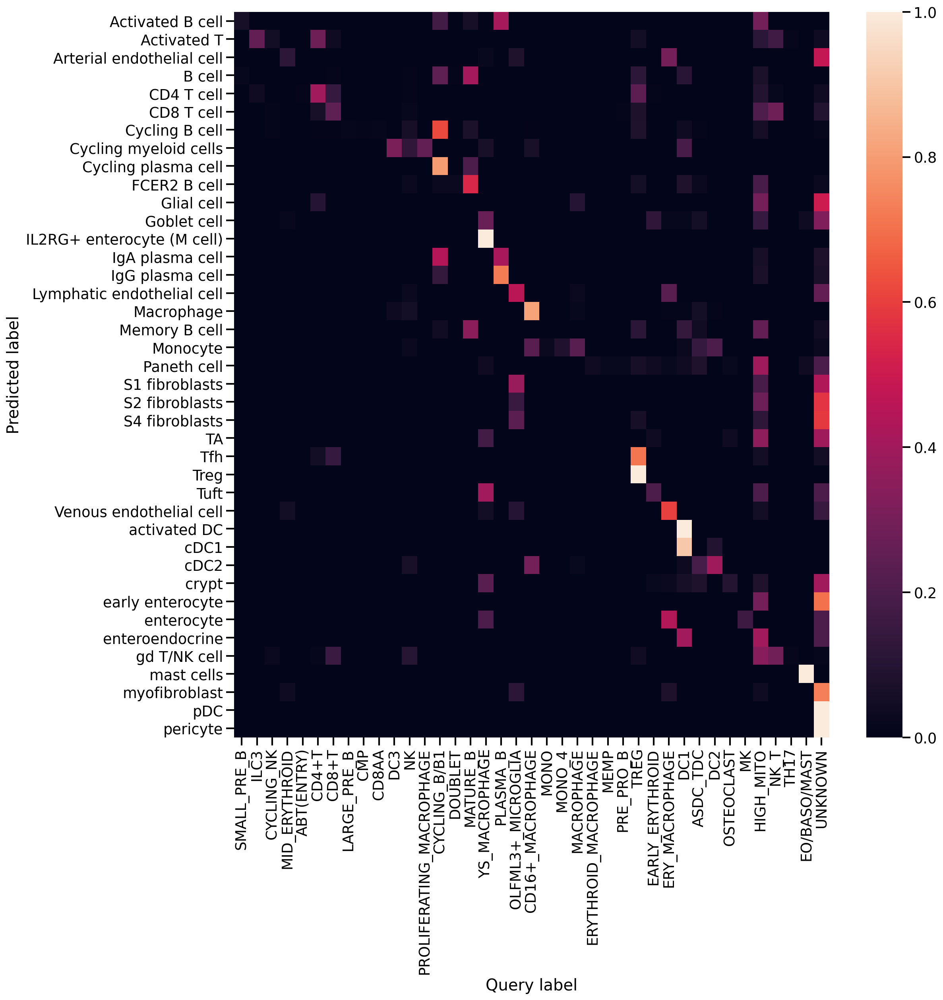

In [141]:
plt.rcParams["figure.figsize"] = [15,15]
plot_confusion_mat(concat_adata, "annotation_V2", show_low_confidence=False)

In [127]:
## Save outs 
# concat_adata.write_h5ad(scvi_outs_dir + "HSC_IMMUNE_with_pedGut.h5ad")

In [60]:
concat_adata_2 = sc.read_h5ad(scvi_outs_dir + "HSC_IMMUNE_with_pedGut.h5ad")

In [61]:
concat_adata_2.obs["annotation_reference"] = np.nan
concat_adata_2.obs.loc[ref_adata.obs_names + "-reference", "annotation_reference"] = anno_obs.loc[ref_adata.obs_names]["anno_lvl_2_final_clean"].values

In [62]:
predict_label(concat_adata_2, "annotation_reference")

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in true_divide


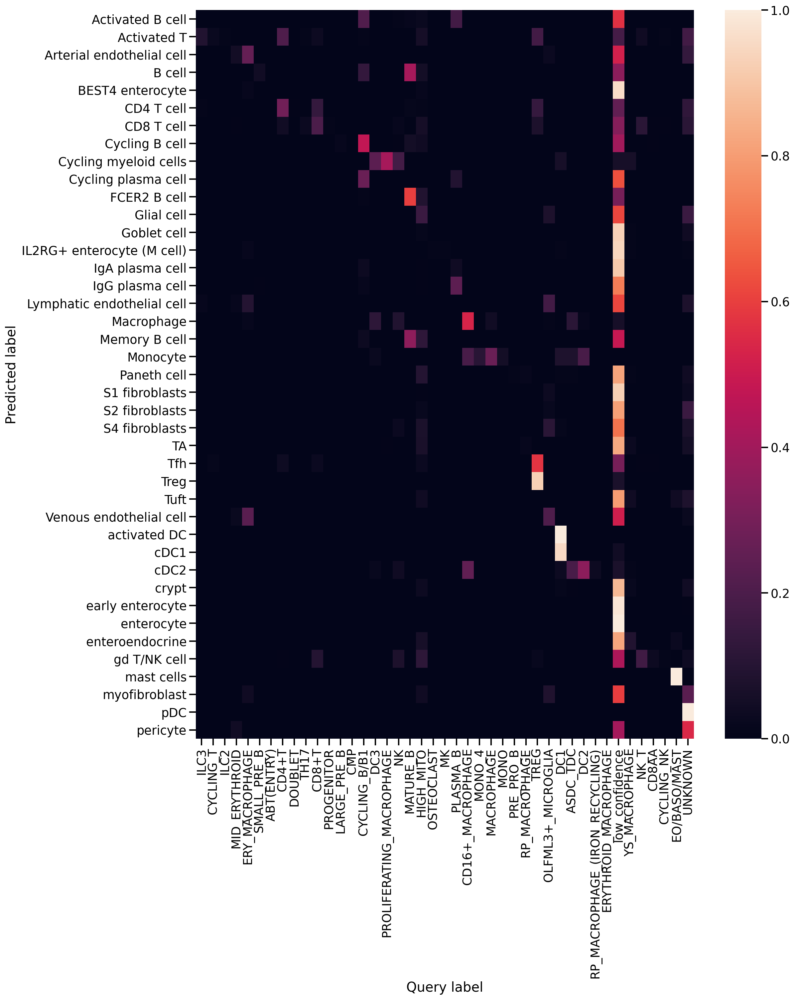

In [144]:
plt.rcParams["figure.figsize"] = [15,18]
plot_confusion_mat(concat_adata_2, "annotation_V2", show_low_confidence=True)

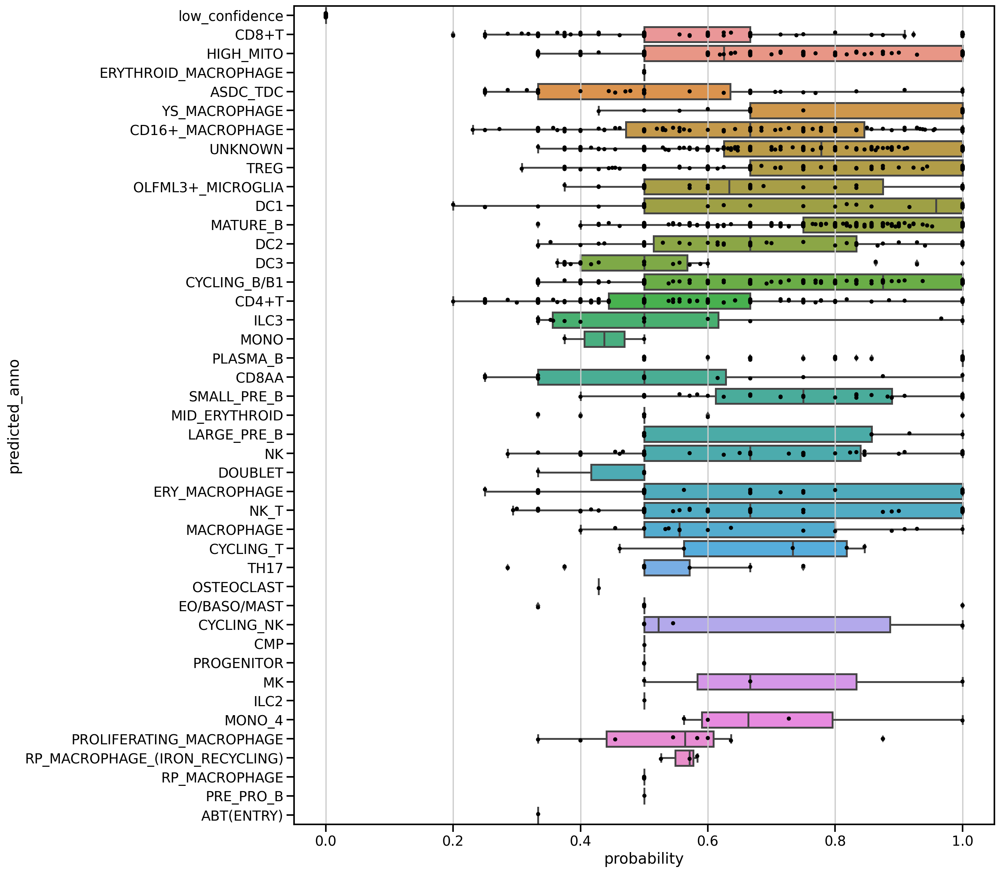

In [69]:
plot_predicted_anno_probability(concat_adata_2)

... storing 'annotation_reference' as categorical
... storing 'predicted_anno' as categorical


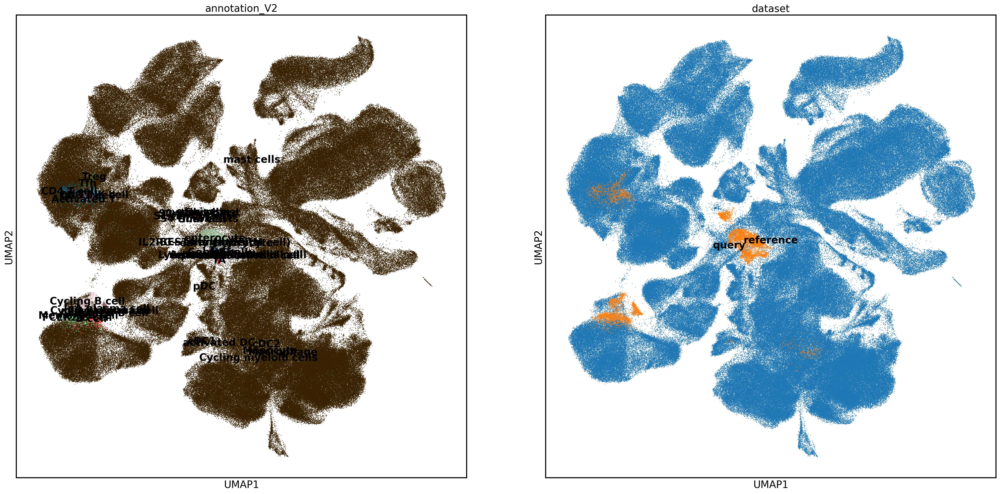

In [45]:
sc.pl.umap(
    concat_adata_2, 
    color=["annotation_V2","dataset"],
    legend_loc="on data",
    size=5
)

In [388]:
nkt_query_adata_mapped, vae_nkt = _map_query_to_panfetal(nkt_query_adata, split="NKT",  
                                            scvi_outs_dir = "/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/",
                                            batch_name="gut_pediatric")

Vars don't overlap -- converting to geneIDs


ValueError: invalid literal for int() with base 10: 'ENSG00000000938'

### Visualize with the reference

In [151]:
split="NKT"
scvi_outs_dir = "/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/"
timestamp = "20210429"

ref_adata = sc.read_h5ad(scvi_outs_dir + 'PAN.A01.v01.entire_data_raw_count.{t}.{s}.h5ad'.format(t=timestamp, s=split))

ref_embedding = np.load(scvi_outs_dir + 'PAN.A01.v01.entire_data_raw_count.{t}.{s}.scVI_out.npy'.format(t=timestamp, s=split))

ref_adata.obsm["X_scvi"] = ref_embedding
ref_adata.var_names = ref_adata.var.GeneID

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [152]:
nkt_query_adata_mapped.obsm["X_scvi"] = nkt_query_adata_mapped.obsm["X_scVI_project"]

In [158]:
nkt_query_adata_mapped.obs = pd.concat([nkt_query_adata_mapped.obs, nkt_query_adata.obs], 1)

In [153]:
concat_adata = ref_adata.concatenate(nkt_query_adata_mapped, batch_key="dataset", batch_categories=["reference", "query"])

In [154]:
sc.pp.neighbors(concat_adata, use_rep="X_scvi", n_neighbors = 30)

In [155]:
sc.tl.umap(concat_adata, min_dist = 0.01, spread = 2)

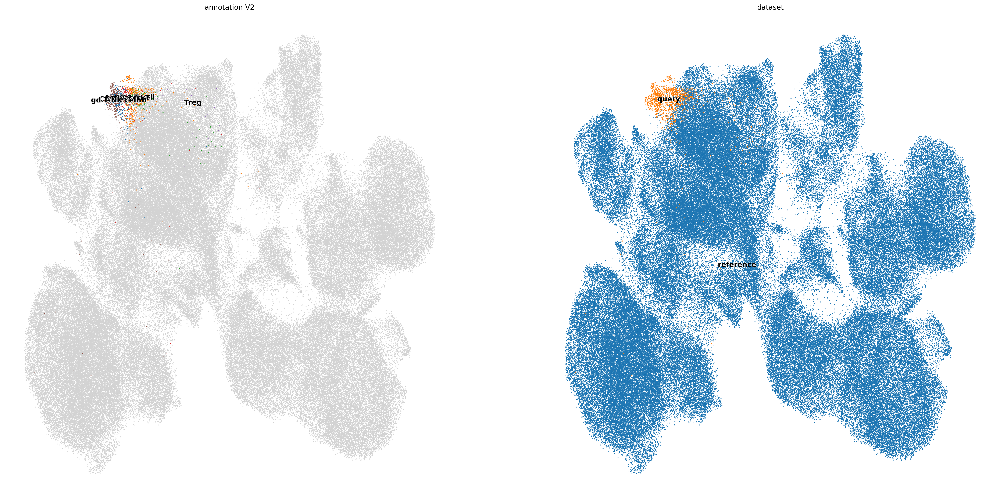

In [168]:
scv.set_figure_params()
plt.rcParams["figure.figsize"] = [15,15]
scv.pl.umap(
    concat_adata, 
    color=["annotation_V2","dataset"],
    legend_loc="on data",
    size=10
)


### Try on subset - use sample info

In [165]:
nkt_cells = [
    'CD4 T cell',
    'CD8 T cell',
    'Treg',
    'gd T/NK cell',
    'Activated T',
    'Tfh'
]

nkt_query_adata = query_adata[query_adata.obs["annotation_V2"].isin(nkt_cells)].copy()

nkt_query_adata.obs["bbk"] = nkt_query_adata.obs["Sample name"]

In [463]:
query_adata.write_h5ad('/home/jupyter/pediatric_RAWCOUNTS_cellxgene.query.with_bbk.h5ad')

In [464]:
query_adata.obs["bbk"] = "ped_gut"
query_adata.write_h5ad('/home/jupyter/pediatric_RAWCOUNTS_cellxgene.query.without_bbk.h5ad')

... storing 'bbk' as categorical


query_adata.write_h5ad('/home/jupyter/pediatric_RAWCOUNTS_cellxgene_NKT.query.h5ad')

In [167]:
nkt_query_adata.('/home/jupyter/pediatric_RAWCOUNTS_cellxgene_NKT.query.h5ad')

In [172]:
h5ad_file = '/home/jupyter/pediatric_RAWCOUNTS_cellxgene_NKT.query.h5ad'
'{p}.mapped2{s}.h5ad'.format(p=h5ad_file.strip(".h5ad"), s=split)

'/home/jupyter/pediatric_RAWCOUNTS_cellxgene_NKT.query.mapped2HSC_IMMUNE.h5ad'

In [166]:
nkt_query_adata_mapped, vae_nkt = _map_query_to_panfetal(nkt_query_adata, split="NKT",  
                                            scvi_outs_dir = "/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/",
                                            batch_name="gut_pediatric")

INFO     .obs[_scvi_labels] not found in target, assuming every cell is same category        
INFO     Using data from adata.X                                                             
INFO     Computing library size prior per batch                                              
INFO     Registered keys:['X', 'batch_indices', 'local_l_mean', 'local_l_var', 'labels']     
INFO     Successfully registered anndata object containing 1252 cells, 7499 vars, 39 batches,
         1 labels, and 0 proteins. Also registered 0 extra categorical covariates and 0 extra
         continuous covariates.                                                              


/opt/conda/lib/python3.7/site-packages/scvi/model/base/_archesmixin.py:94: UserWarning: Query integration should be performed using models trained with version >= 0.8
  "Query integration should be performed using models trained with version >= 0.8"
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 200/200: 100%|██████████| 200/200 [00:19<00:00, 10.48it/s, loss=797, v_num=1] 


In [138]:
nkt_query_adata_mapped.write_h5ad("/home/jupyter/query_mapped.h5ad")

In [15]:
nkt_query_adata_mapped = sc.read_h5ad("/home/jupyter/query_mapped.h5ad")

#### Visualize with the reference

In [16]:
split="NKT"
scvi_outs_dir = "/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/"
timestamp = "20210429"

ref_adata = sc.read_h5ad(scvi_outs_dir + 'PAN.A01.v01.entire_data_raw_count.{t}.{s}.h5ad'.format(t=timestamp, s=split))
ref_embedding = np.load(scvi_outs_dir + 'PAN.A01.v01.entire_data_raw_count.{t}.{s}.scVI_out.npy'.format(t=timestamp, s=split))
ref_adata.obsm["X_scvi"] = ref_embedding
ref_adata.var_names = ref_adata.var.GeneID

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [17]:
nkt_query_adata_mapped.obsm["X_scvi"] = nkt_query_adata_mapped.obsm["X_scVI_project"]

In [18]:
# nkt_query_adata_mapped.obs = pd.concat([nkt_query_adata_mapped.obs, nkt_query_adata.obs], 1)
# nkt_query_adata_mapped.obs = nkt_query_adata_mapped.obs.loc[:,~nkt_query_adata_mapped.obs.columns.duplicated(keep="first")]

In [19]:
concat_adata = ref_adata.concatenate(nkt_query_adata_mapped, batch_key="dataset", batch_categories=["reference", "query"])

In [20]:
sc.pp.neighbors(concat_adata, use_rep="X_scvi", n_neighbors = 30)

In [21]:
sc.tl.umap(concat_adata, min_dist = 0.01, spread = 2)

... storing 'file' as categorical
... storing 'name' as categorical
... storing 'Age' as categorical
... storing 'Diagnosis' as categorical
... storing 'Sample name' as categorical
... storing 'Type' as categorical
... storing 'batch' as categorical
... storing 'annotation_V2' as categorical
... storing 'inferred state' as categorical
... storing 'bbk' as categorical


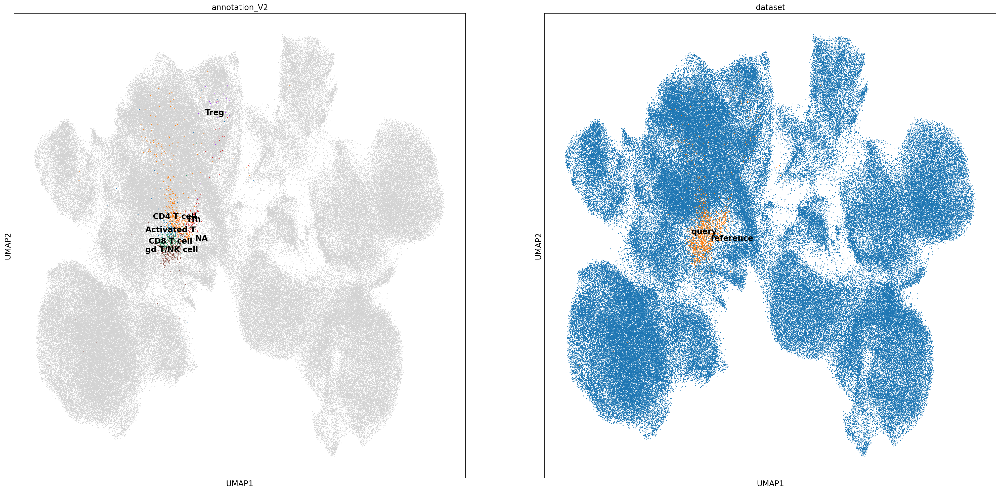

In [24]:
# scv.set_figure_params()
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.umap(
    concat_adata, 
    color=["annotation_V2","dataset"],
    legend_loc="on data",
    size=10
)


## Propagate annotation

In [48]:
NKT_anno = pd.read_csv("/home/jupyter/Pan_fetal_immune/metadata/manual_annotation/PAN.A01.v01.entire_data_normalised_log.20210429.LYMPHOID.csv", index_col=0)

In [51]:
ref_adata.obs["anno_lvl_2"] = NKT_anno["anno_lvl_2"].loc[ref_adata.obs_names]

In [60]:
concat_adata.obs['anno_lvl_2'] = np.nan
concat_adata.obs.loc[concat_adata.obs.dataset=="reference", "anno_lvl_2"] = ref_adata.obs["anno_lvl_2"].loc[concat_adata.obs_names[concat_adata.obs.dataset=="reference"].str.strip("-reference")].values

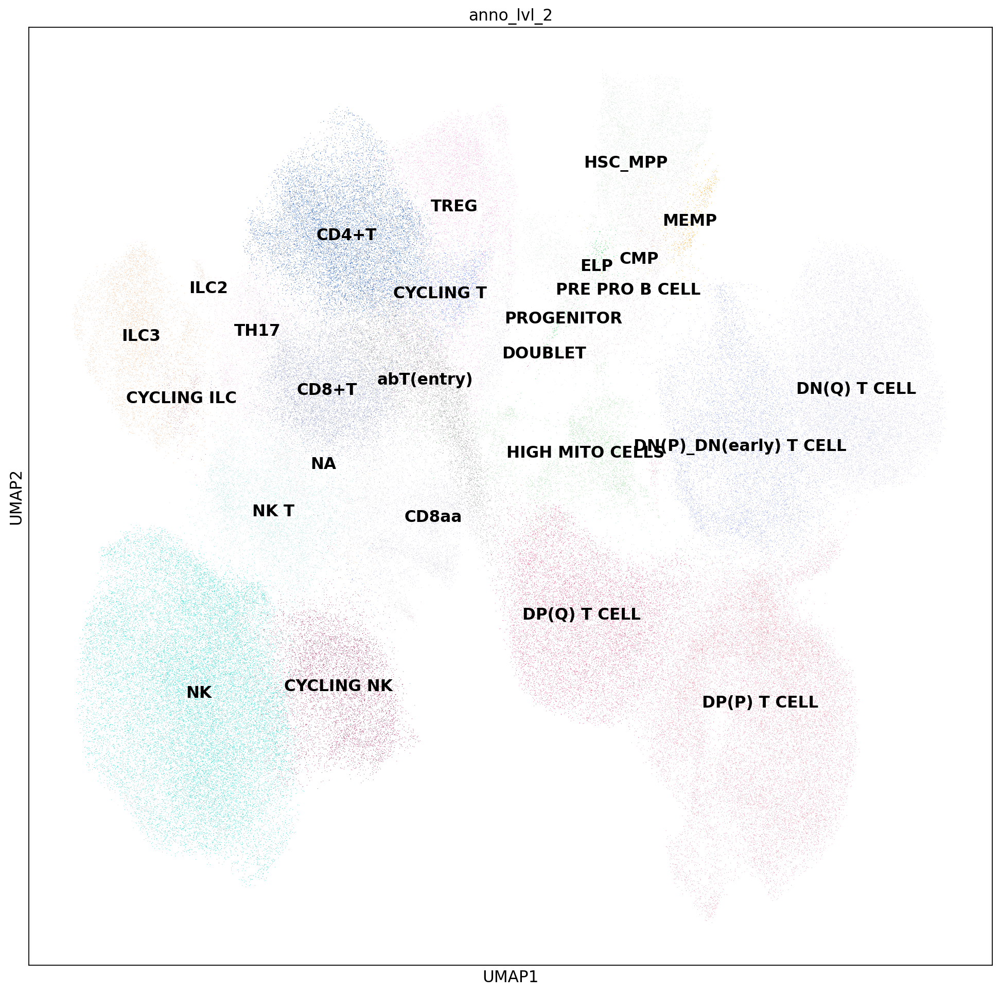

In [62]:
sc.pl.umap(concat_adata, color="anno_lvl_2", legend_loc="on data")

In [216]:
def predict_label(adata, neighbors_key = 'connectivities'):
    '''
    Predict labels on query data based on joint KNN graph
    '''
    min_ref_neighbors = adata.uns["neighbors"]["params"]["n_neighbors"]/10
    missing_anno = adata.obs["dataset"] == "query"

    ## Find neighbors of cells with conflicting annotation
    knn_graph = adata.obsp[neighbors_key]
    knn_graph_query = knn_graph[missing_anno,:]
    knn_graph_query[knn_graph_query.nonzero()] = 1

    import scipy

    ## Find most abundant cell label in neighbors
    neighbors_labels = pd.DataFrame()
    n_neighbors_labels = pd.DataFrame()

    annos = adata.obs[anno_col].copy()

    dummy_df = pd.get_dummies(annos)
    dummy_mat = scipy.sparse.csr_matrix(dummy_df)

    new_anno = knn_graph_query.dot(dummy_mat).toarray()

    n_neighbors = np.array(knn_graph_query.sum(1)).flatten()
    n_neighbors_ref = new_anno.sum(axis=1)
    new_anno_prob = new_anno.T/n_neighbors_ref
    new_anno_prob[np.isnan(new_anno_prob)] = 0
    new_anno_prob[:,n_neighbors_ref < min_ref_neighbors] = 0

    best_label = dummy_df.columns[new_anno_prob.argmax(0)]
    best_label_score = new_anno_prob.max(0)

    adata.obs.loc[missing_anno,'predicted_anno'] = best_label
    adata.obs.loc[missing_anno,'predicted_anno_prob'] = best_label_score

def plot_confusion_mat(adata, query_anno_col):
    '''
    Plot confusion matrix of predicted labels VS labels pre-existing in query dataset
    '''
    missing_anno = adata.obs["dataset"] == "query"
    conf_mat = sc.metrics.confusion_matrix(query_anno_col, "predicted_anno", adata[missing_anno].obs, normalize=True)
    sns.heatmap(conf_mat);
    plt.xlabel("Predicted label");
    plt.ylabel("Query label");

def plot_predicted_anno_probability(adata):
    missing_anno = adata.obs["dataset"] == "query"
    best_label_df = adata.obs[missing_anno]

    sns.stripplot(data=best_label_df, y="predicted_anno", x="predicted_anno_prob", orient='h', color="black");
    sns.boxplot(data=best_label_df, y="predicted_anno", x="predicted_anno_prob", orient='h', color=None);
    plt.xlabel("probability")

In [210]:
predict_label(adata)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in true_divide


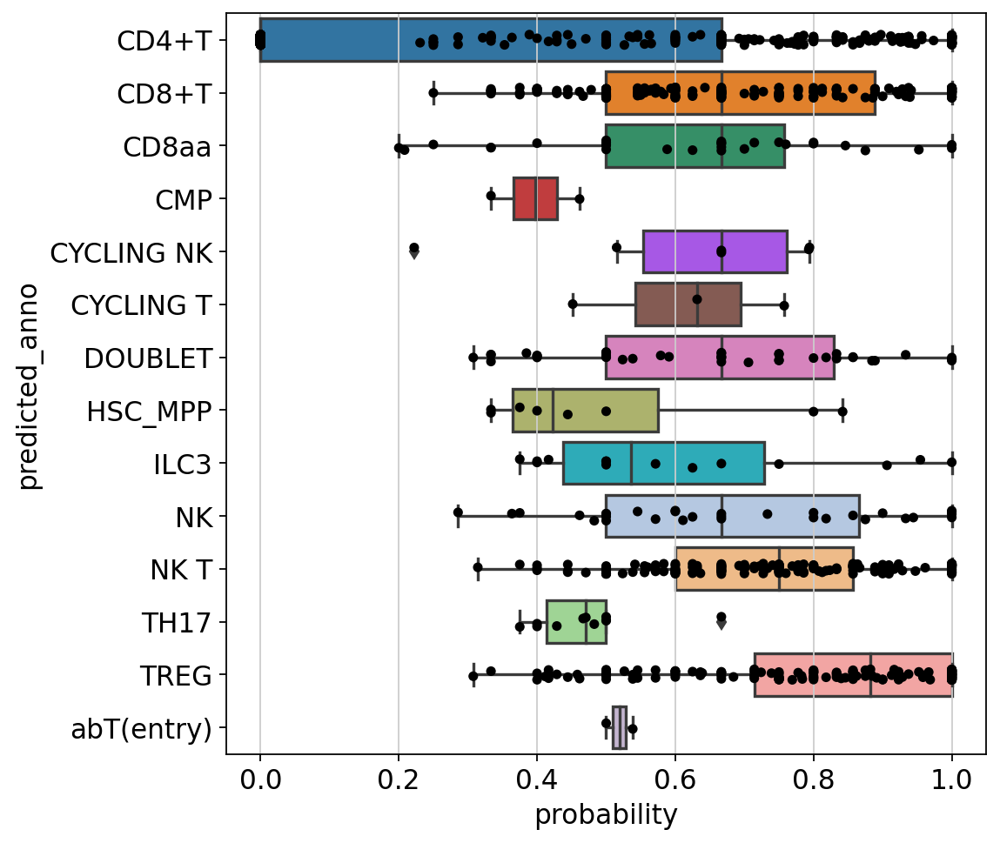

In [217]:
plot_predicted_anno_probability(adata)

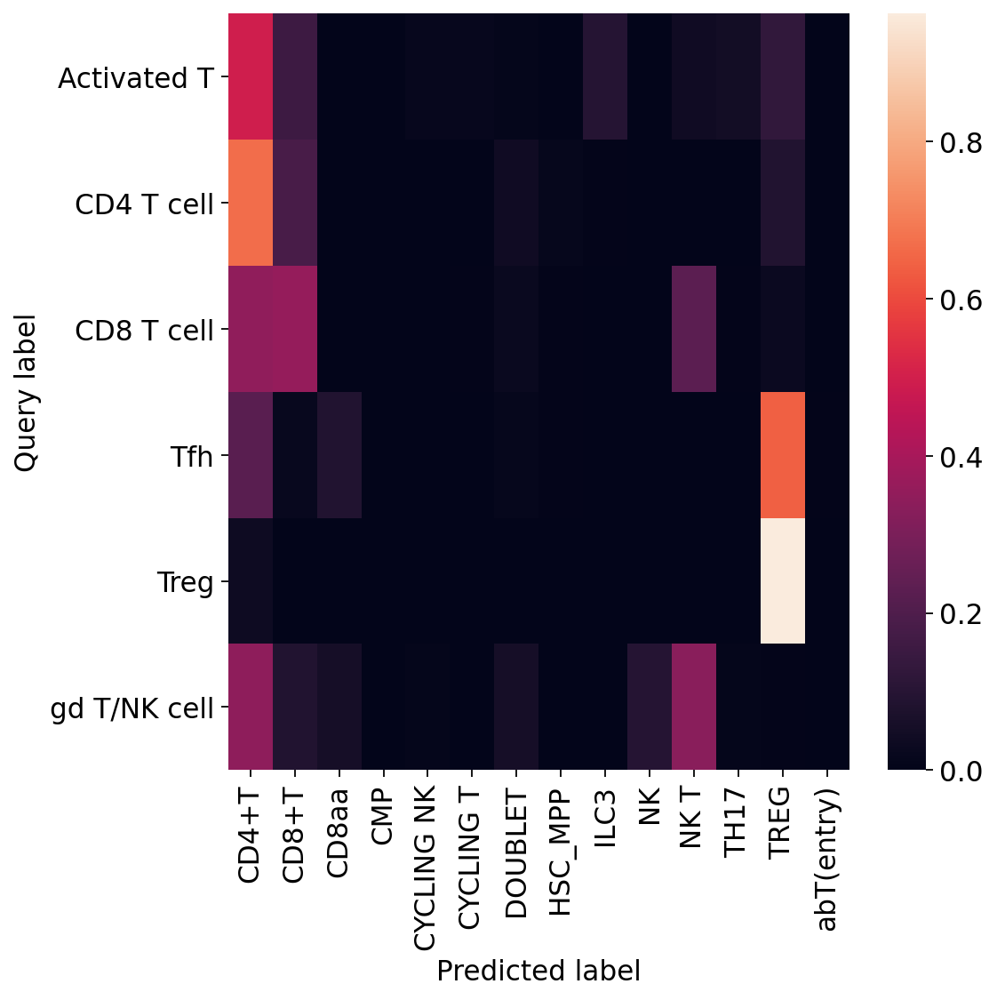

In [219]:
plot_confusion_mat(adata, "annotation_V2");

## Adult thymus data

In [8]:
th_adata = sc.read_h5ad("/home/jupyter/mount/gdrive/Pan_fetal/data4gpu_node/HTA08.v01.A05.Science_human_fig1.h5ad")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [10]:
th_adata.X.max()

11.262365

---

## Quantify accuracy of integration
- Bio conservation: are cell from with the same label in query dataset closer toghether than random?

In [231]:
query_anno_col="annotation_V2"

In [256]:
missing_anno = adata.obs["dataset"] == "query"
query_d = adata.obsp['distances'][missing_anno,:][:,missing_anno].toarray()
anno_dummies = pd.get_dummies(adata.obs[missing_anno][query_anno_col])

query_d[anno_dummies["CD4 T cell"]==1, anno_dummies["CD4 T cell"]==1]
# query_d[]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0.

In [ ]:
sc.read_h5ad(scvi_outs_dir + "HSC_IMMUNE_with_pedGut.h5ad")